# Image Perturbation
This is a notebook that implements a custom image perturbation algorithm for digital animation.

## What is Image Perturbation?
Excellent question.  Check this out.

![Perturbed Image URL](https://media.giphy.com/media/v1.Y2lkPTc5MGI3NjExenVydWM1bnU0bWlzNzB0YmFsNDE1YXdwdnN3Y2ZicmJiZ2puaGZnOCZlcD12MV9pbnRlcm5hbF9naWZfYnlfaWQmY3Q9Zw/4imBd6JqnFoR5YkgGA/giphy.gif "perturbed image url")

This GIF comes from a Youtube Short from an account called Natural Habitat Shorts that I really like.  They post funny little shorts with animals, but each post is about some random animal fun fact.  This one I discovered when I read that platypi can fluoresce under black light and I went down a youtube rabbit hole learning about platypi.  Here's the link: https://www.youtube.com/shorts/Zxf2MgYCOm0.

Notice how even in moments where the platypus is still, the image still wiggles and moves.  For scenes that have some element of animacy to them, this is a really important way of making the animation richer and fuller.  I'm no animation genius, but I have watched Avatar: The Last Airbender several times, so I think I'm at least qualified to point out that this is a cool and useful feature.

But how do animators do this?  Well, I don't actually know.  In the worst case, I assume that they just draw the same image two or three times and then just loop them together.  That sounds pretty terrible to me, and so I got to thinking that it would be pretty cool to create a program that could take a still image and make the borders wiggle just like we see here.

I call this process **image perturbation**.

In [375]:
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np

The following cells will be helpful for loading images into arrays we can work with.

In [376]:
def get_pil_img(img_path, show=False):
    return Image.open(img_path)

def get_np_img(img):
    return np.array(img)

# this turns the image into a binary image of 0s and 1s instead of having shades of gray between 0-255
def binarize_image(img_arr):
    less_than = np.where(img_arr < 255 // 2)
    greater_than = np.where(img_arr >= 255 // 2)

    arr_binary = img_arr.copy()
    arr_binary[less_than] = 0
    arr_binary[greater_than] = 255
    return arr_binary

# shows a plt img of an np image array.  Defaults to binary_r cmap, otherwise it just does the actual plt.imshow default cmap
def show_img_plt(img_arr, binary_cmap=True):
    if binary_cmap: plt.imshow(img_arr, cmap="binary_r")
    else: plt.imshow(img_arr)
    plt.show()

# uses plt to animate frames (list of np image arrays) together where each frame is interval ms long (or something like that)
def show_animation(frames, interval=100):
        # Function to update the animation for each frame
        def update(frame):
            plt.clf()  # Clear the previous frame
            plt.imshow(frames[frame], "binary_r")
            plt.axis('off')  # Turn off axis labels

        # Set up the figure
        fig = plt.figure()

        # Create the animation
        animation = FuncAnimation(fig, update, frames=len(frames), interval=interval, repeat=True)
        plt.show()

def get_animation(frames, interval=100):
    plt.rcParams['figure.figsize'] = [8, 8]
    fig, ax = plt.subplots()
    img = ax.imshow(frames[0], cmap='binary_r')  # Assuming grayscale images

    def animate(i):
        img.set_array(frames[i])
        return img,

    return animation.FuncAnimation(fig, animate, frames=len(frames), interval=interval, blit=True)

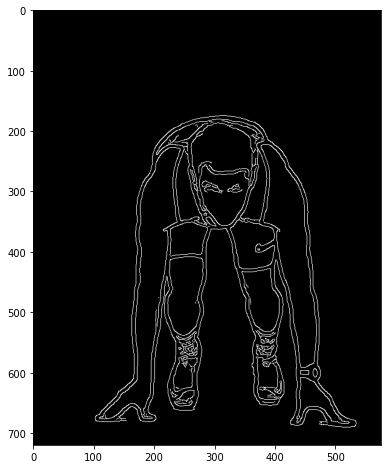

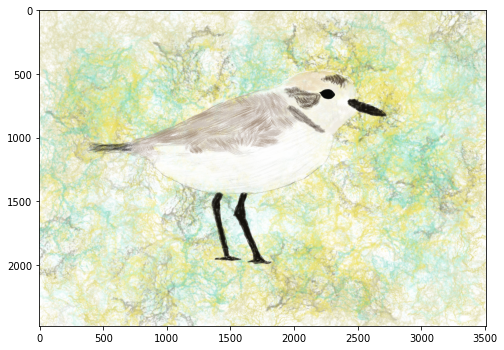

In [377]:
img_path_1 = "assets/Miles-Zoltak.jpg"
img_path_2 = "assets/plover.png"

img_1 = get_pil_img(img_path_1)
img_arr_1 = get_np_img(img_1)
img_arr_1 = binarize_image(img_arr_1)
show_img_plt(img_arr_1)

img_2 = get_pil_img(img_path_2)
img_arr_2 = get_np_img(img_2)
show_img_plt(img_arr_2, binary_cmap=False)

Obviously these are two very different images.  The black and white one is an old picture of me from my T&F days that I ran through a line detection algorithm.  The second is a picture of a snowy plover I drew (still learning).  We're going to work primarily with the first one as we try to figure out a way to get lines to wiggle.  And then we'll move onto using a full image to decompose lines and make them wiggle and then bring the image back together.  I honestly don't know how this is gonna go.

## Perturbing Myself
So let's start with the black and white image of myself.  I'm thinking that complex sine/cosine functions are going to be good for what we're trying to do.  By complex I just mean adding together a set of sine/cosine functions that vary along their amplitudes and periods.  Think of it as the reverse of a Short Term Fourier Transformation or something like that.

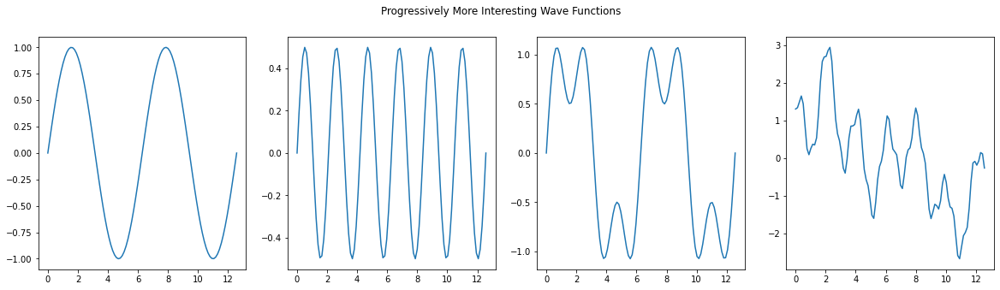

<Figure size 57600x21600 with 0 Axes>

In [378]:
# widen the plt figsize
plt.rcParams['figure.figsize'] = [20, 5]

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4)
fig.set_figure(plt.figure(figsize=(800, 300)))
fig.suptitle('Progressively More Interesting Wave Functions')

x = np.linspace(0, 4 * np.pi, 100)

y1 = np.sin(x)
y2 = 0.5 * np.sin(3 * x)
y3 = y1 + y2
y4 = y3 + 1.3 * np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)

ax1.plot(x, y1)
ax2.plot(x, y2)
ax3.plot(x, y3)
ax4.plot(x, y4)

(from left to right)<br/>
Figure 1: $y = \sin(x)$<br/>
Figure 2: $y = \frac{1}{2}\sin(3x)$<br/>
Figure 3: $y = \sin(x) + \frac{1}{2}\sin(3x)$ (Note that this is just Figure 1 + Figure 2, our first complex function!)<br/>
Figure 4: $y = \sin(x) + \frac{1}{2}\sin(3x) + 1.3\cos(\pi x) + \sin(\frac{x}{2}) - \frac{1}{3} \sin(10x)$ (Note, it's real complex now)<br>

So as we can see, we've got something that's pretty interesting looking.  Let's see how we might be able to use this to perturb an image.

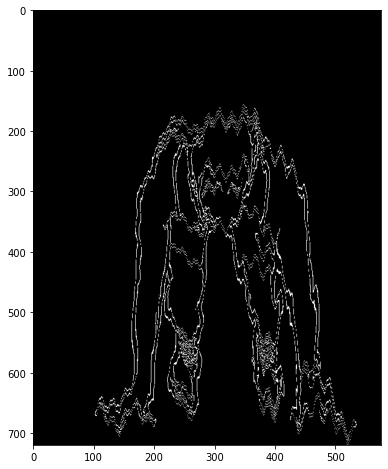

In [379]:
height, width = img_arr_1.shape
ys, xs = np.where(img_arr_1 != 0)

wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)

# we will progressively scale the output of wavefunc to increase the amount of perturbation
frames = []
for i in range(0, 10):
    perturbation = i * wavefunc(xs / 10)
    new_img = np.zeros_like(img_arr_1)
    new_img[np.minimum(np.int32(ys + perturbation), height - 1), xs] = 1
    frames.append(new_img)
ani = get_animation(frames, 50)
HTML(ani.to_jshtml())

### Yeah, that looks sick.
But it looks to me like scaling by a factor of 1 or 2 is really all we need.

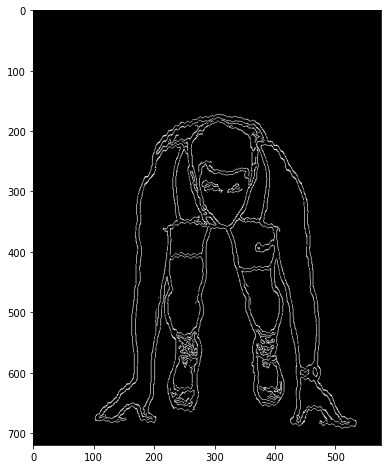

In [380]:
# we will progressively scale the output of wavefunc to increase the amount of perturbation
ys, xs = np.where(img_arr_1 != 0)
wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)
perturbation = wavefunc(xs / 5)
new_img = np.zeros_like(img_arr_1)
new_img[np.minimum(np.int32(ys + perturbation), height - 1), xs] = 255
ani = get_animation([img_arr_1, new_img], 200)
HTML(ani.to_jshtml())

And while this is great, we run into the problem that this is only perturbing in the +/- y direction.  If we want some really robust wiggles, we're going to need to be able to perturb not just in the +/- y direction, but normal to the direction of a given point on a curve.

To do that, we're going to need to be able to calculate the instantaneous slope at a given point.  Let's see if we can figure out how to do that...

## Interlude: Instantaneous Slope
We know we can determine a point's slope by looking at its immediate neighbors, so we need to figure out a way of doing that and also tune the hyperparameter that represents exactly what a "neighborly" distance is.  As I've got it configured here, I think 5 is a pretty good value for that distance hyperparameter.  If you want to be able to see the regions a littl more clearly I recommend temporarily cranking `MAX_DIST` up to 50 or so, just make sure to turn it back down or your slope values will be meaningless.

NOTE: When I say a point having some "distance" away from some other point I'm really referring to the x and y components of the vector since that's easier than Euclidean distance and I didn't do Manhattan distance cuz I didn't feel like it.

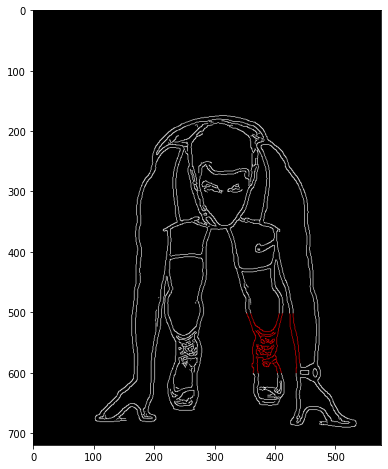

In [474]:
MAX_DIST = 50
frames = []
for i in range(100):
    idx = np.random.choice(len(xs))
    x, y = xs[idx], ys[idx]
    xs_in = (x - MAX_DIST < xs) & (xs < x + MAX_DIST)
    ys_in = (y - MAX_DIST < ys) & (ys < y + MAX_DIST)
    neighbors = np.where((xs_in & ys_in) == True)

    ch2 = img_arr_1.copy()
    ch3 = img_arr_1.copy()

    ch2[ys[neighbors], xs[neighbors]] = 0
    ch3[ys[neighbors], xs[neighbors]] = 0

    height, width = img_arr_1.shape
    color_img = np.zeros((height, width, 3), dtype=np.int32)
    color_img[:, :, 0] = img_arr_1
    color_img[:, :, 1] = ch2
    color_img[:, :, 2] = ch3
    frames.append(color_img)
ani = get_animation(frames, 100)
HTML(ani.to_jshtml())

So now let's see if we can calculate instantaneous slope on any of those regions.

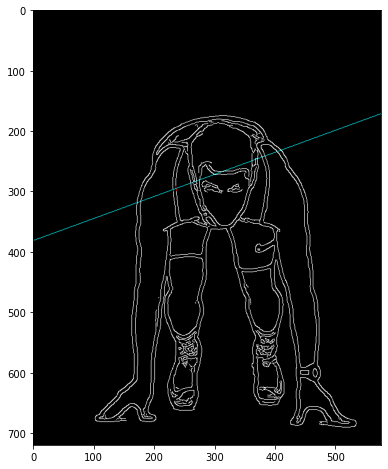

In [382]:
from scipy.stats import linregress
MAX_DIST = 5

frames = []
for i in range(50):
    idx = np.random.choice(len(xs))
    x, y = xs[idx], ys[idx]
    xs_in = (x - MAX_DIST < xs) & (xs < x + MAX_DIST)
    ys_in = (y - MAX_DIST < ys) & (ys < y + MAX_DIST)
    neighbors = np.where((xs_in & ys_in) == True)

    x_vals = xs[neighbors]
    y_vals = ys[neighbors]

    # catch the case in which we only have one x value (slope undefined, linregress throws error)
    if (len(np.unique(x_vals)) > 1):
        result = linregress(x_vals, y_vals)
        slope = result.slope
        intercept = result.intercept

        line_func = lambda x: slope * x + intercept
        inv_line_func = lambda y: (y - intercept) / slope

        tan_x_1 = np.arange(width)
        tan_y_1 = np.int32(line_func(tan_x_1))
        in_bounds = np.where((0 <= tan_y_1) & (tan_y_1 < height))
        tan_y_1 = tan_y_1[in_bounds]
        tan_x_1 = tan_x_1[in_bounds]

        tan_y_2 = np.arange(height)
        tan_x_2 = np.int32(inv_line_func(tan_y_2))
        in_bounds = np.where((0 <= tan_x_2) & (tan_x_2 < width))
        tan_x_2 = tan_x_2[in_bounds]
        tan_y_2 = tan_y_2[in_bounds]
    else:
        tan_x_1 = [np.unique(x_vals)[0]] * height
        tan_y_1 = np.arange(height)
        
    ch1 = img_arr_1.copy()
    ch2 = img_arr_1.copy()
    ch3 = img_arr_1.copy()

    ch1[ys[neighbors], xs[neighbors]] = 0
    ch2[ys[neighbors], xs[neighbors]] = 0
    ch3[ys[neighbors], xs[neighbors]] = 0

    ch1[tan_y_1, tan_x_1] = 255
    ch2[tan_y_1, tan_x_1] = 255
    ch3[tan_y_1, tan_x_1] = 255

    ch1[tan_y_2, tan_x_2] = 255
    ch2[tan_y_2, tan_x_2] = 255
    ch3[tan_y_2, tan_x_2] = 255


    height, width = img_arr_1.shape
    color_img = np.zeros((height, width, 3), dtype=np.int32)
    color_img[:, :, 0] = img_arr_1
    color_img[:, :, 1] = ch2
    color_img[:, :, 2] = ch3
    frames.append(color_img)
ani = get_animation(frames, 500)
HTML(ani.to_jshtml())

This is pretty neat!  You might say: "Yeah, pretty good.  But sometimes the tangent line isn't what I would expect it to be, so it's not perfect.  To that I would reply with a line from one of my favorite poems called "How to Be Perfect" by Ron Padgett:
>Know that the only perfect things are a 300 game in bowling and a<br/>
>27-batter, 27-out game in baseball.

Not to mention this line, which may be my favorite in the whole poem:
>Know that the desire to be perfect is probably the veiled expression<br/>
>of another desire—to be loved, perhaps, or not to die.

Among my other favorite lines from that poem are:<br/>
this one
>Don't stay angry about anything for more than a week, but don't<br/>
>forget what made you angry. Hold your anger out at arm's length<br/>
>and look at it, as if it were a glass ball. Then add it to your glass ball<br/>
>collection.<br/>

and

>Be kind to old people, even when they are obnoxious. When you<br/>
>become old, be kind to young people. Do not throw your cane at<br/>
>them when they call you Grandpa. They are your grandchildren!<br/>

and

>Forgive your country every once in a while. If that is not possible, go<br/>
>to another one.<br/>

But that's beside the point! You can find the poem [here](https://www.poetryfoundation.org/poems/57243/how-to-be-perfect).

About the slope lines not being perfect.  I agree.  I am going to chalk that up to our relatively naive assumption that the slope of the line can be inferred from the best fit of the points around it, which makes sense for lines that are relatively straight, but a lot of squigglyness can probably just make it guess a slope of 0.  Also, this image is a little funky because it has a sort of double-walled line structure if you look closely.  It looks cool, but it gives this naive approach some issues.

One way to fix this might be to stipulate that the points that make up the neighborhood of a given point where we want to find instantaneous slope must be contiguous with that point.  There are a couple more considerations that must be made if we take that tack, but we'll worry about that further down the line if we find that it is necessary to revisit this slope-finding algorithm.

For now, let's say we have concluded out Instantaneous Slop Interlude!
## Interlude Complete!  Let's incorporate what we've found.

In [383]:
from scipy.stats import linregress
MAX_DIST = 5

slopes = {}
ys, xs = np.where(img_arr_1 != 0)

for x, y in zip(xs, ys):
    xs_in = (x - MAX_DIST < xs) & (xs < x + MAX_DIST)
    ys_in = (y - MAX_DIST < ys) & (ys < y + MAX_DIST)
    neighbors = np.where((xs_in & ys_in) == True)

    x_vals = xs[neighbors]
    y_vals = ys[neighbors]

    # catch the case in which we only have one x value (slope undefined, linregress throws error)
    if len(np.unique(x_vals)) > 1:
        result = linregress(x_vals, y_vals)
        slope = result.slope
    else:
        slope = np.inf
    
    slopes[f"{y}_{x}"] = slope

In [446]:
ys, xs = np.where(img_arr_1 != 0)

idx = 944

x, y = xs[idx], ys[idx]

xs_in = (x - MAX_DIST < xs) & (xs < x + MAX_DIST)
ys_in = (y - MAX_DIST < ys) & (ys < y + MAX_DIST)
neighbors = np.where((xs_in & ys_in) == True)

x_vals = xs[neighbors]
y_vals = ys[neighbors]

slopes[f"{y}_{x}"] == np.inf

True

Now that we have the normals, we can *try* to use some trigonometry magic to align the perturbaition along the normal instead of along the y axis.

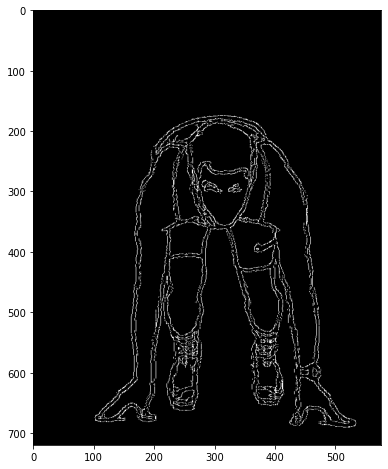

In [466]:
# we will progressively scale the output of wavefunc to increase the amount of perturbation
height, width = img_arr_1.shape
ys, xs = np.where(img_arr_1 != 0)
wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)
perturbations = wavefunc(xs / 5)
new_img = np.zeros_like(img_arr_1)

perturb_x = lambda theta, perturbations: np.cos(np.array([t if t != np.inf else 0 for t in theta])) * perturbations
perturb_y = lambda theta, perturbations: np.sin(np.array([t if t != np.inf else 1 for t in theta])) * perturbations

thetas = np.array([slopes[f"{y}_{x}"] for x,y in zip(xs, ys)])


x_pert = perturb_x(thetas, perturbations)
y_pert = perturb_y(thetas, perturbations)

new_xs = np.int32(np.minimum(xs + x_pert, width - 1))
new_ys = np.int32(np.minimum(ys + y_pert, height - 1))
new_img[new_ys, new_xs] = 255

ani = get_animation([img_arr_1, new_img], 200)
HTML(ani.to_jshtml())

Hmm... This doesn't look great.  Maybe if we tune our hyperparameter (the period of the wave function) it will be better?

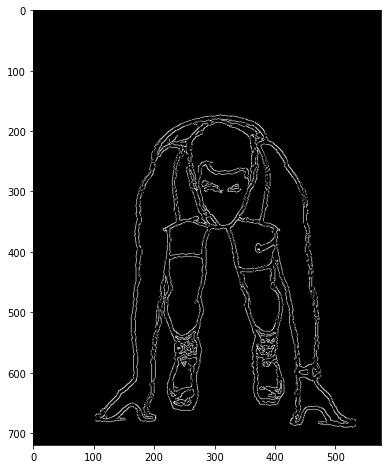

In [465]:
# we will progressively scale the output of wavefunc to increase the amount of perturbation
height, width = img_arr_1.shape
ys, xs = np.where(img_arr_1 != 0)
frames = []
for i in range(1, 50):
    wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)
    perturbations = wavefunc(xs / i)
    new_img = np.zeros_like(img_arr_1)

    perturb_x = lambda theta, perturbations: np.cos(np.array([t if t != np.inf else 0 for t in theta])) * perturbations
    perturb_y = lambda theta, perturbations: np.sin(np.array([t if t != np.inf else 1 for t in theta])) * perturbations

    thetas = np.array([slopes[f"{y}_{x}"] for x,y in zip(xs, ys)])
    x_pert = perturb_x(thetas, perturbations)
    y_pert = perturb_y(thetas, perturbations)

    new_xs = np.int32(np.minimum(np.maximum(xs + x_pert, 0), width - 1))
    new_ys = np.int32(np.minimum(np.maximum(ys + y_pert, 0), height - 1))
    new_img[new_ys, new_xs] = 255
    frames.append(new_img)

ani = get_animation(frames, 200)
HTML(ani.to_jshtml())

I would say that... yes, increasing the period does help, but we are still getting something that feels more like static and less like a wave.

But in the spirit of transparency, I will say that before I had the above code I was using a different lambda function for my `perturb_x` and `perturb_y` functions.

In the above I have: `perturb_x = lambda theta, perturbations: np.cos(np.array([t if t != np.inf else 0 for t in theta])) * perturbations` which takes into account the angle value of a slope (as `theta`) and extracts the x component of it.  A similar function is defined for the y component.

However, I was using this function before that: `perturb_x = lambda theta, perturbations: np.cos(x) * perturbations`.  Let's talk about that.

Right away, we notice that we aren't using the `theta` variable of the lambda, so what is `x` here?

Well, it turns out `x` is just some random integer I had in the kernel from some debugging.  As I write this, it is 392. `y` is set to 551 apparently.  What a strange world we live in.

Let's see what that looks like using these lambdas and that `x` and `y` value.

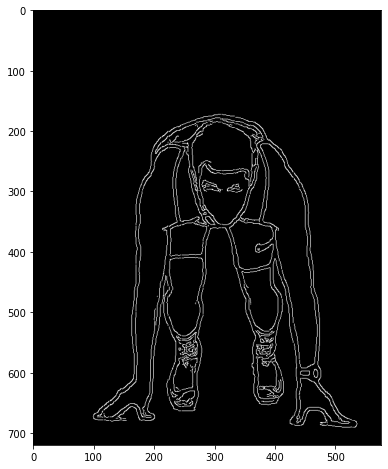

In [493]:
# setting x to 392 and y to 551 because it is ~cannon~ and it demonstrates my own experience as I was coding this
x = 392
y = 551

# we will progressively scale the output of wavefunc to increase the amount of perturbation
height, width = img_arr_1.shape
ys, xs = np.where(img_arr_1 != 0)
wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)
perturbations = wavefunc(xs / 50)
new_img = np.zeros_like(img_arr_1)

perturb_x = lambda theta, perturbations: np.cos(x) * perturbations
perturb_y = lambda theta, perturbations: np.sin(y) * perturbations

thetas = np.array([slopes[f"{y}_{x}"] for x,y in zip(xs, ys)])


x_pert = perturb_x(thetas, perturbations)
y_pert = perturb_y(thetas, perturbations)

new_xs = np.int32(np.minimum(xs + x_pert, width - 1))
new_ys = np.int32(np.minimum(ys + y_pert, height - 1))
new_img[new_ys, new_xs] = 255

ani = get_animation([img_arr_1, new_img], 200)
HTML(ani.to_jshtml())

It actually looks pretty good! What's crazy is I spent so much time trying to do the whole instantaneous slope thing so that I could do some perturbations in the x direction too, and as it turns out I could have basically just taken the cosine of any random number and done it.  Circumstantially, this works out.  Let's put it in a for-loop and add `i * 10` to the x values going into the wavefunction to basically make the waves flow (as compared to scaling the period of the wave which we've done a couple times now as we search for a hyperparameter).  Feel free to set `x` and `y` to whatever you want. It doesn't seem to make a meaningful difference.

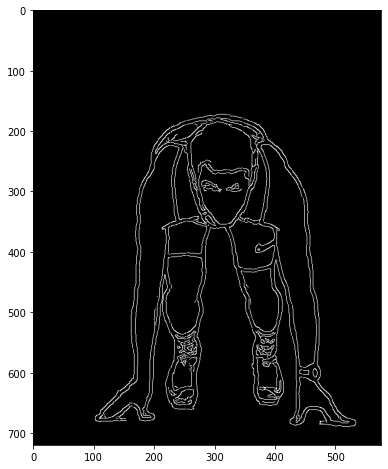

In [494]:
height, width = img_arr_1.shape

ys, xs = np.where(img_arr_1 != 0)
frames = []
for i in range(1, 50):
    wavefunc = lambda x: np.sin(x) + 0.5 * np.cos(3 * x) + np.cos(np.pi * x) + np.sin(0.5 * x) - 0.25 * np.sin(10 * x)
    # adding i * 10 makes the wave "flow", or basically just translates it along the x axis
    perturbations = wavefunc((xs + i * 10) / 50)
    new_img = np.zeros_like(img_arr_1)

    perturb_x = lambda theta, perturbations: np.cos(x) * perturbations
    perturb_y = lambda theta, perturbations: np.sin(y) * perturbations

    thetas = np.array([slopes[f"{y}_{x}"] for x,y in zip(xs, ys)])

    x_pert = perturb_x(thetas, perturbations)
    y_pert = perturb_y(thetas, perturbations)

    new_xs = np.int32(np.minimum(np.maximum(xs + x_pert, 0), width - 1))
    new_ys = np.int32(np.minimum(np.maximum(ys + y_pert, 0), height - 1))
    new_img[new_ys, new_xs] = 255
    frames.append(new_img)

ani = get_animation(frames, 200)
HTML(ani.to_jshtml())

YES! It looks SICK!  This is honestly great news because it simplifies the logic of our code and the time/space complexity too.  I'm satisfied with this.  However, it is only a small part of a much larger problem that involves decomposition, coloring, and recomposition.

This is going up in a blog post, and you'll have to wait on a part 2 to see how the next step goes!